<a href="https://colab.research.google.com/github/Nisha40108/Mark-Park/blob/main/Masking_and_Predicting3.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [1]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [2]:
from __future__ import division
import matplotlib.pyplot as plt
import matplotlib.image as mpimg
import cv2
import os, glob
import numpy as np
from moviepy.editor import VideoFileClip
cwd = os.getcwd()

%matplotlib inline
%config InlineBackend.figure_format = 'retina'

In [3]:
def show_images(images, cmap=None):
    cols = 2
    rows = (len(images)+1)//cols

    plt.figure(figsize=(15, 12))
    for i, image in enumerate(images):
        plt.subplot(rows, cols, i+1)
        # use gray scale color map if there is only one channel
        cmap = 'gray' if len(image.shape)==2 else cmap
        plt.imshow(image, cmap=cmap)
        plt.xticks([])
        plt.yticks([])
    plt.tight_layout(pad=0, h_pad=0, w_pad=0)
    plt.show()

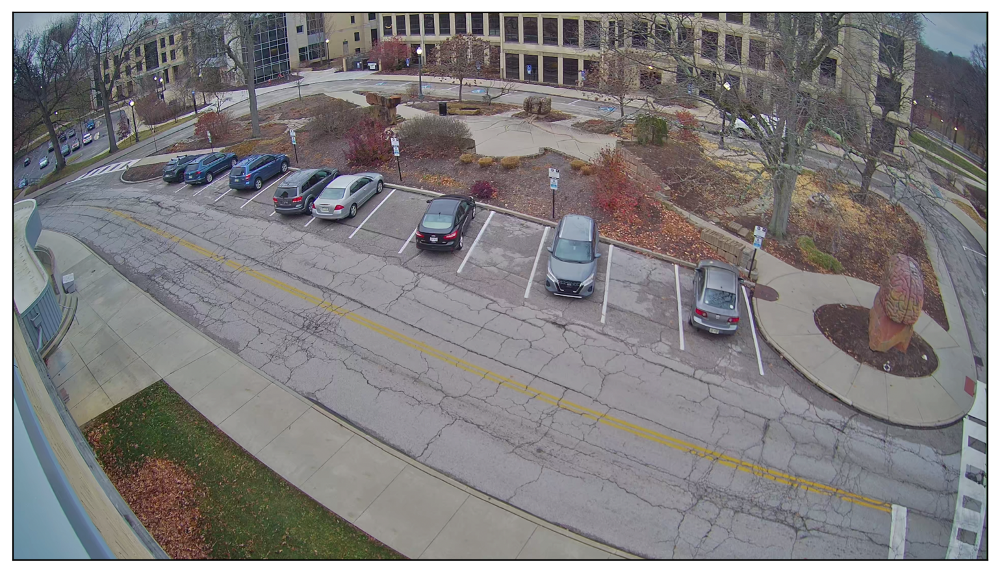

In [4]:
import cv2
import numpy as np
import glob
import matplotlib.pyplot as plt

images = [plt.imread(path) for path in glob.glob('/content/drive/MyDrive/nisha/test_images/RGBparkinglot2.png')]
show_images(images)

In [5]:
def print_image_info(images):
    for i, image in enumerate(images):
        # Check if the image is a NumPy array
        if isinstance(image, np.ndarray):
            # Extract file name from the path
            file_name = f"test_image_{i+1}.png"  # You may need to adjust this based on your actual file names

            # Print information about the image
            print(f"Image {i+1} (File: {file_name}) shape:", image.shape)
            print(f"Image {i+1} (File: {file_name}) type:", image.dtype)

            # Check number of channels and convert to RGB if it has an alpha channel
            if image.shape[2] == 4:
                print("Converting image to RGB.")
                image_rgb = cv2.cvtColor(image, cv2.COLOR_RGBA2RGB)
                print("Shape of image_rgb:", image_rgb.shape)
            else:
                print("Image is already RGB.")
                image_rgb = image.copy()

            image_rgb = image_rgb.astype(np.uint8)
            print("Image data type (after conversion):", image_rgb.dtype)
            print("Minimum pixel value:", np.min(image_rgb))
            print("Maximum pixel value:", np.max(image_rgb))
        else:
            print(f"Image {i+1} is not a NumPy array")

# Assuming 'images' is a list of images
print_image_info(images)


Image 1 (File: test_image_1.png) shape: (2160, 3840, 3)
Image 1 (File: test_image_1.png) type: float32
Image is already RGB.
Image data type (after conversion): uint8
Minimum pixel value: 0
Maximum pixel value: 1


Converting image to uint8.


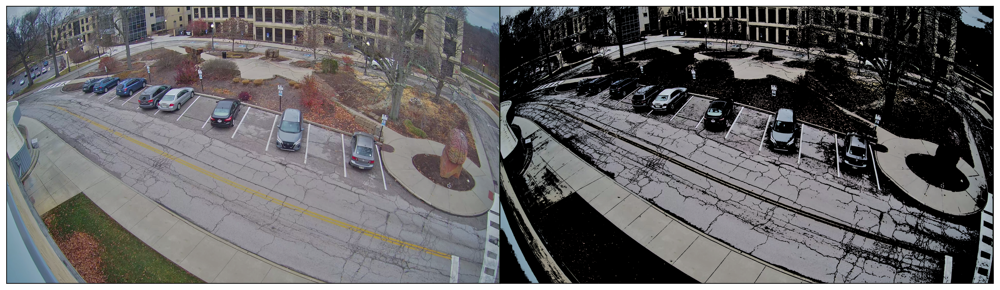

In [6]:
def select_rgb_white_yellow(image):
    # Convert image to 3 channels (remove alpha channel if present)
    image_rgb = cv2.cvtColor(image, cv2.COLOR_RGBA2RGB) if image.shape[2] == 4 else image

    # Convert image to uint8 if not already
    if image_rgb.dtype != np.uint8:
        print("Converting image to uint8.")
        image_rgb = (image_rgb * 255).astype(np.uint8)

    # Define white color mask
    lower_white = np.array([127, 127, 127], dtype=np.uint8)
    upper_white = np.array([255, 255, 255], dtype=np.uint8)
    white_mask = cv2.inRange(image_rgb, lower_white, upper_white)

    # Define yellow color mask
    lower_yellow = np.array([191, 191, 0], dtype=np.uint8)
    upper_yellow = np.array([255, 255, 255], dtype=np.uint8)
    yellow_mask = cv2.inRange(image_rgb, lower_yellow, upper_yellow)

    # Combine the masks
    combined_mask = cv2.bitwise_or(white_mask, yellow_mask)

    # Apply the combined mask to the original image
    masked_image = cv2.bitwise_and(image_rgb, image_rgb, mask=combined_mask)

    return masked_image

# Assuming 'test_images' is a single image
single_test_image = images[0]
white_yellow_image = select_rgb_white_yellow(single_test_image)
show_images([single_test_image, white_yellow_image])

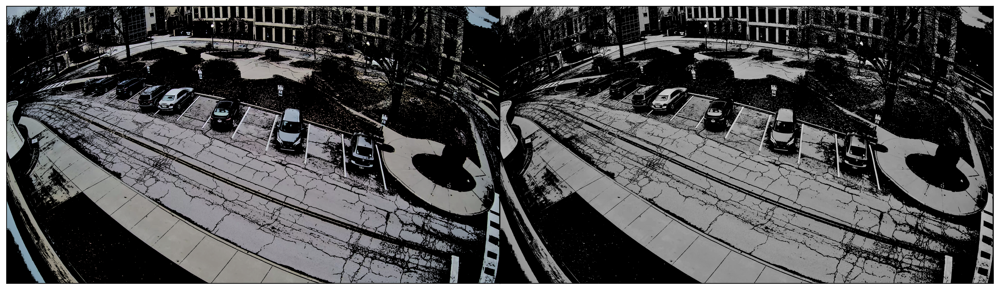

In [7]:
def convert_gray_scale(image):
    return cv2.cvtColor(image, cv2.COLOR_RGB2GRAY)

# Assuming 'white_yellow_image' is a single image
gray_image = convert_gray_scale(white_yellow_image)

# Display the grayscale image
show_images([white_yellow_image, gray_image])

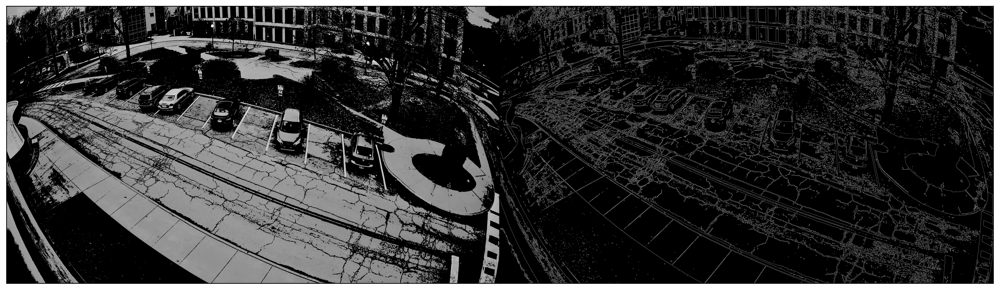

In [8]:
def detect_edges(image, low_threshold=50, high_threshold=200):
    return cv2.Canny(image, low_threshold, high_threshold)

# Assuming 'gray_image' is a single grayscale image
edge_image = detect_edges(gray_image)

# Display the original grayscale image and the edge-detected image
show_images([gray_image, edge_image])

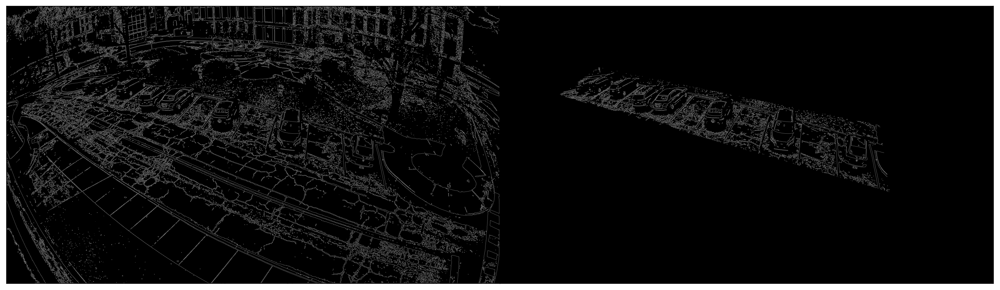

In [9]:
def filter_region(image, vertices):
    """
    Create the mask using the vertices and apply it to the input image
    """
    mask = np.zeros_like(image)
    if len(mask.shape)==2:
        cv2.fillPoly(mask, vertices, 255)
    else:
        cv2.fillPoly(mask, vertices, (255,)*mask.shape[2]) # in case, the input image has a channel dimension
    return cv2.bitwise_and(image, mask)


def select_region(image):
    """
    It keeps the region surrounded by the `vertices` (i.e. polygon).  Other area is set to 0 (black).
    """
    # first, define the polygon by vertices
    rows, cols = image.shape[:2]
    pt_1  = [cols*0.12, rows*0.32]
    pt_2 = [cols*0.79, rows*0.67]
    pt_3 = [cols*0.77, rows*0.43]
    pt_4 = [cols*0.20, rows*0.22]

    # the vertices are an array of polygons (i.e array of arrays) and the data type must be integer
    vertices = np.array([[pt_1, pt_2, pt_3, pt_4]], dtype=np.int32)
    return filter_region(image, vertices)


# Assuming 'edge_image' is a single edge-detected image
roi_image = select_region(edge_image)

# Display the original edge-detected image and the region of interest (ROI) image
show_images([edge_image, roi_image])

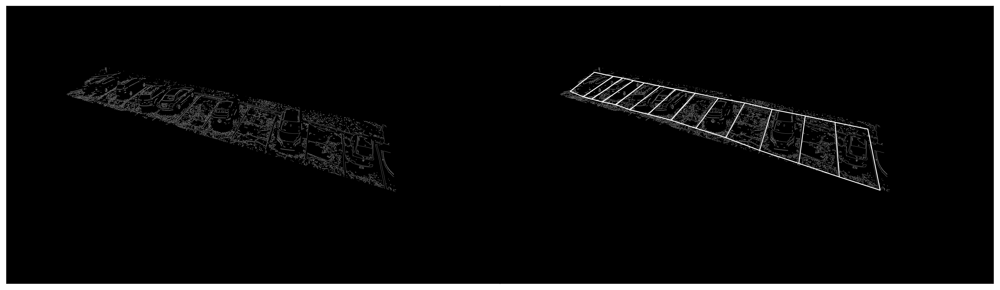

In [10]:
import cv2
import numpy as np
import matplotlib.pyplot as plt

# Assuming roi_image is already defined

pt_1=[2862,957]
pt_2=[2958,1433]
pt_3=[2607,904]
pt_4=[2640,1330]
pt_5=[2375,854]
pt_6=[2325,1224]
pt_7=[2116,803]
pt_8=[2020,1123]
pt_9=[1904,753]
pt_10=[1756,1023]
pt_11=[1700,715]
pt_12=[1524,950]
pt_13=[1519,677]
pt_14=[1330,887]
pt_15=[1368,647]
pt_16=[1151,841]
pt_17=[1247,622]
pt_18=[1010,806]
pt_19=[1123,597]
pt_20=[899,766]
pt_21=[1038,579]
pt_22=[796,745]
pt_23=[955,559]
pt_24=[713,723]
pt_25=[881,546]
pt_26=[647,705]
pt_27=[734,514]
pt_28=[546,662]


color = (255, 0, 0)
thickness = 5

# Create a copy of the image to avoid modifying the original
image_with_line = np.copy(roi_image)

# Define vertices for each polyline
vertices1 = np.array([pt_1, pt_2, pt_4, pt_3], np.int32).reshape((-1, 1, 2))
vertices2 = np.array([pt_3, pt_4, pt_6, pt_5], np.int32).reshape((-1, 1, 2))
vertices3 = np.array([pt_5, pt_6, pt_8, pt_7], np.int32).reshape((-1, 1, 2))
vertices4 = np.array([pt_7, pt_8, pt_10, pt_9], np.int32).reshape((-1, 1, 2))
vertices5 = np.array([pt_9, pt_10, pt_12, pt_11], np.int32).reshape((-1, 1, 2))
vertices6 = np.array([pt_11, pt_12, pt_14, pt_13], np.int32).reshape((-1, 1, 2))
vertices7 = np.array([pt_13, pt_14, pt_16, pt_15], np.int32).reshape((-1, 1, 2))
vertices8 = np.array([pt_15, pt_16, pt_18, pt_17], np.int32).reshape((-1, 1, 2))
vertices9 = np.array([pt_17, pt_18, pt_20, pt_19], np.int32).reshape((-1, 1, 2))
vertices10 = np.array([pt_19, pt_20, pt_22, pt_21], np.int32).reshape((-1, 1, 2))
vertices11 = np.array([pt_21, pt_22, pt_24, pt_23], np.int32).reshape((-1, 1, 2))
vertices12 = np.array([pt_23, pt_24, pt_26, pt_25], np.int32).reshape((-1, 1, 2))
vertices13 = np.array([pt_25, pt_26, pt_28, pt_27], np.int32).reshape((-1, 1, 2))

# Draw the polylines on the image
X1 = cv2.polylines(image_with_line, [vertices1], isClosed=True, color=color, thickness=thickness)
X2 = cv2.polylines(image_with_line, [vertices2], isClosed=True, color=color, thickness=thickness)
x3 = cv2.polylines(image_with_line, [vertices3], isClosed=True, color=color, thickness=thickness)
x4 = cv2.polylines(image_with_line, [vertices4], isClosed=True, color=color, thickness=thickness)
x5 = cv2.polylines(image_with_line, [vertices5], isClosed=True, color=color, thickness=thickness)
x6 = cv2.polylines(image_with_line, [vertices6], isClosed=True, color=color, thickness=thickness)
x7 = cv2.polylines(image_with_line, [vertices7], isClosed=True, color=color, thickness=thickness)
x8 = cv2.polylines(image_with_line, [vertices8], isClosed=True, color=color, thickness=thickness)
x9 = cv2.polylines(image_with_line, [vertices9], isClosed=True, color=color, thickness=thickness)
x10 = cv2.polylines(image_with_line, [vertices10], isClosed=True, color=color, thickness=thickness)
x11 = cv2.polylines(image_with_line, [vertices11], isClosed=True, color=color, thickness=thickness)
x12 = cv2.polylines(image_with_line, [vertices12], isClosed=True, color=color, thickness=thickness)
x13 = cv2.polylines(image_with_line, [vertices13], isClosed=True, color=color, thickness=thickness)

# Show the images
show_images([roi_image, image_with_line])


In [11]:
def hough_lines(image):
    """
    `image` should be the output of a Canny transform.

    Returns hough lines (not the image with lines)
    """
    return cv2.HoughLinesP(image, rho=0.1, theta=np.pi/10, threshold=15, minLineLength=50, maxLineGap=50)


list_of_lines = list(map(hough_lines, roi_image))

 No lines detected:  14


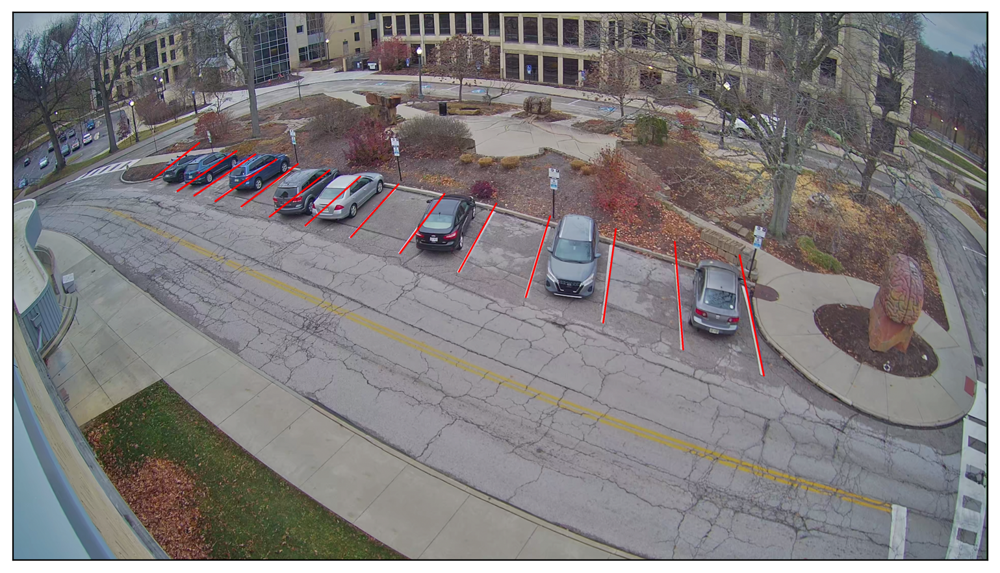

In [12]:
def draw_lines_with_points(image, points, color=[255, 0, 0], thickness=5, make_copy=True):
    if make_copy:
        image = np.copy(image)
    cleaned = []

    # Define pairs of points to draw lines
    line_points = [
      (734,514,546,662),
(881,546,647,705),
(955,559,713,723),
(1038,579,796,745),
(1123,597,899,766),
(1247,622,1010,806),
(1368,647,1151,841),
(1519,677,1330,887),
(1700,715,1524,950),
(1904,753,1756,1023),
(2116,803,2020,1123),
(2375,854,2325,1224),
(2607,904,2640,1330),
(2862,957,2958,1433)
    ]

    for x1, y1, x2, y2 in line_points:
        cleaned.append((x1, y1, x2, y2))
        cv2.line(image, (x1, y1), (x2, y2), color, thickness)

    print(" No lines detected: ", len(cleaned))
    return image

# Example usage:
images_test = images

points = [(734,514),
(546,662),
(881,546),
(647,705),
(955,559),
(713,723),
(1038,579),
(796,745),
(1123,597),
(899,766),
(1247,622),
(1010,806),
(1368,647),
(1151,841),
(1519,677),
(1330,887),
(1700,715),
(1524,950),
(1904,753),
(1756,1023),
(2116,803),
(2020,1123),
(2375,854),
(2325,1224),
(2607,904),
(2640,1330),
(2862,957),
(2958,1433)]

line_images = []
for image, lines in zip(images_test, list_of_lines):
    line_images.append(draw_lines_with_points(image, lines))

show_images(line_images)


Num Parking Lanes:  1


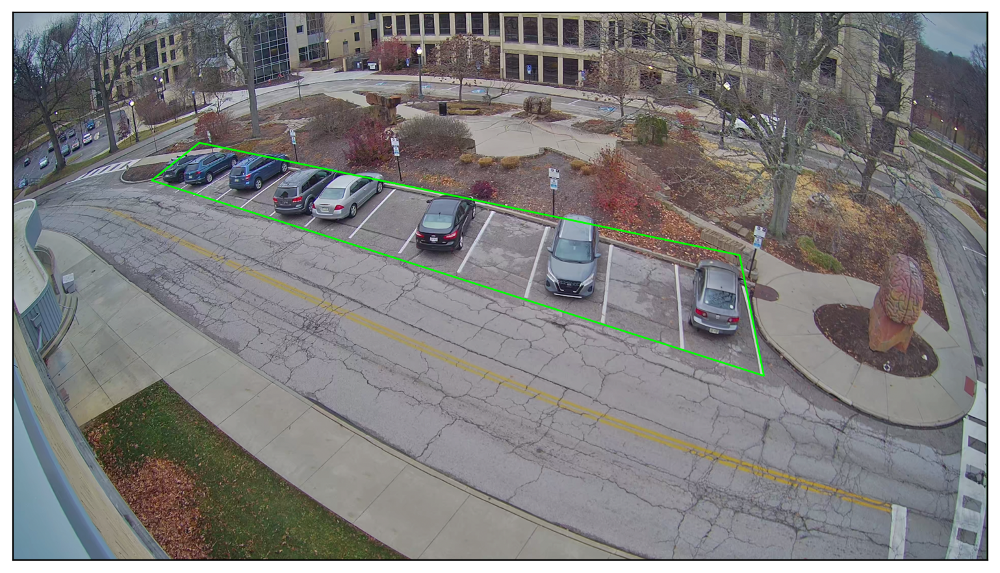

In [13]:
polygon_coords = [
   (546, 662),
    (734, 514),
    (2862, 957),
    (2958, 1433),
]

import cv2
import numpy as np

def identify_polygon(image, polygon_coords, make_copy=True):
    if make_copy:
        new_image = np.copy(image)

    # Convert the list of tuples to a NumPy array
    polygon_coords_np = np.array(polygon_coords, dtype=np.int32)

    # Reshape the array to have one row per point and two columns for x and y
    polygon_coords_np = polygon_coords_np.reshape((-1, 1, 2))

    # Draw the polygon
    cv2.polylines(new_image, [polygon_coords_np], isClosed=True, color=(0, 255, 0), thickness=5)

    return new_image

# Assuming you have defined images_test
lane_images = []
num_lanes = 0  # Initialize the count

for image in images_test:
    new_image = identify_polygon(image, polygon_coords)
    lane_images.append(new_image)
    num_lanes += 1  # Increment the count for each image

# Assuming you have a function show_images defined
print("Num Parking Lanes: ", num_lanes)
show_images(lane_images)


Total parking spaces:  14


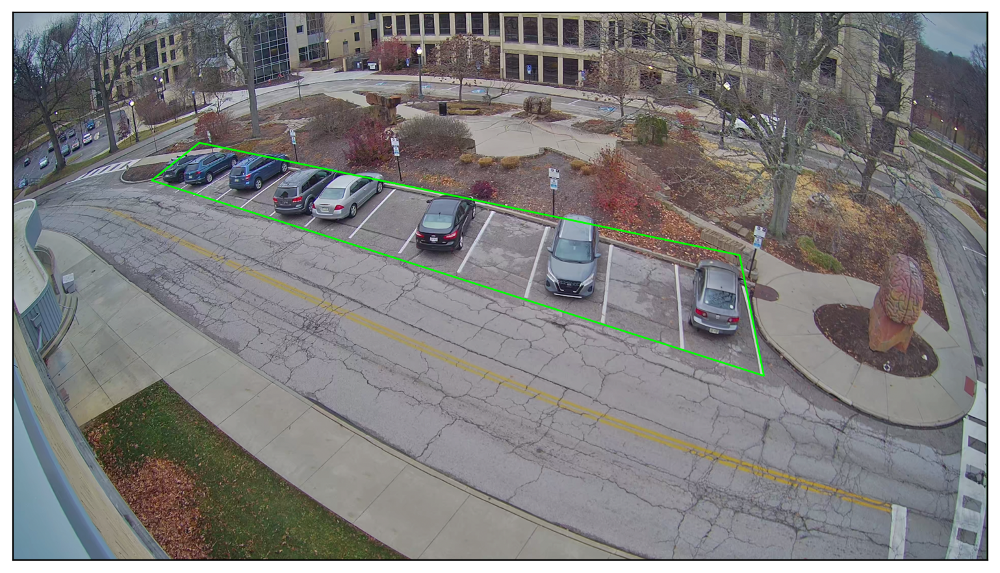

In [14]:
import cv2
import numpy as np

def identify_polygon(image, polygon_coords, make_copy=True):
    if make_copy:
        new_image = np.copy(image)
    else:
        new_image = image

    # Convert the list of tuples to a NumPy array
    polygon_coords_np = np.array(polygon_coords, dtype=np.int32)

    # Reshape the array to have one row per point and two columns for x and y
    polygon_coords_np = polygon_coords_np.reshape((-1, 1, 2))

    # Draw the polygon
    cv2.polylines(new_image, [polygon_coords_np], isClosed=True, color=(0, 255, 0), thickness=5)

    return new_image

def draw_parking(image, polygon_coords, lines, make_copy=True):
    if make_copy:
        new_image = np.copy(image)
    else:
        new_image = image

    new_image = identify_polygon(new_image, polygon_coords, make_copy=False)

    spot_dict = {}  # Maps each parking ID to its coords
    tot_spots = 0

    for i in range(len(lines)):
        # Check if the tuple has the expected number of elements
        if len(lines[i]) != 4:
            print(f"Skipping line {i + 1}. Expected 4 values for each line.")
            continue

        # Horizontal lines
        x1, y1, x2, y2 = lines[i]

        # Add up spots in this lane
        tot_spots += 1

        # Dictionary of spot positions
        spot_dict[(x1, y1, x2, y2)] = tot_spots

    print("Total parking spaces: ", tot_spots)
    return new_image, spot_dict

# Define the coordinates for parking lines
line_points = [
     (2862,957,2958,1433),
(2607,904,2640,1330),
(2375,854,2325,1224),
(2116,803,2020,1123),
(1904,753,1756,1023),
(1700,715,1524,950),
(1519,677,1330,887),
(1368,647,1151,841),
(1247,622,1010,806),
(1123,597,899,766),
(1038,579,796,745),
(955,559,713,723),
(881,546,647,705),
(734,514,546,662)
]

# Define the coordinates for the polygon
polygon_coords = [
    (546, 662),
    (734, 514),
    (2862, 957),
    (2958, 1433),
]

# Assuming you have defined images_test
delineated = []
spot_pos = []

for image in images_test:
    # Assuming list_of_lines is available
    new_image, spot_dict = draw_parking(image, polygon_coords, line_points)
    delineated.append(new_image)
    spot_pos.append(spot_dict)

show_images(delineated)


Total parking spaces:  13


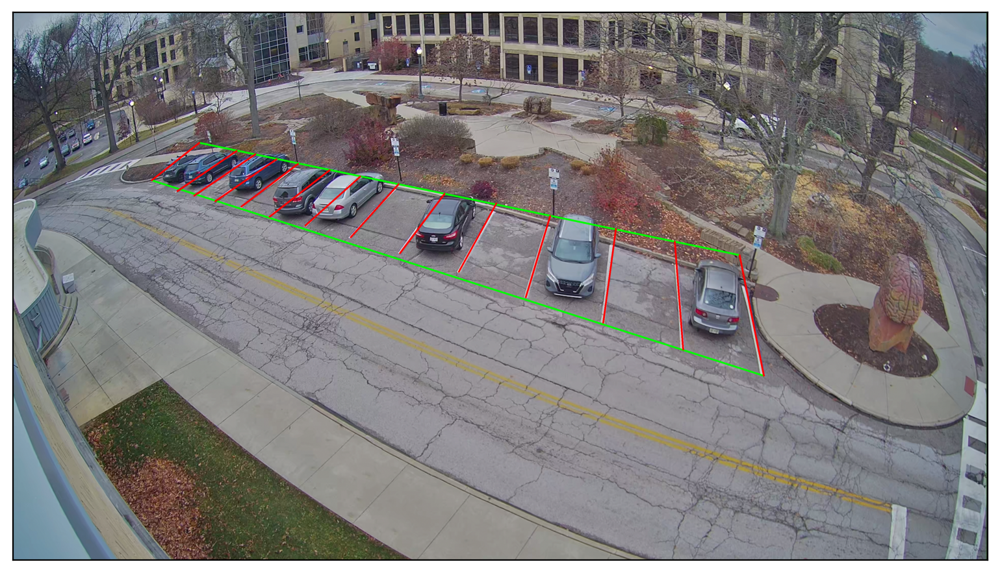

In [19]:
import cv2
import numpy as np

def draw_parking(image, polygon_coords, lines, make_copy=True):
    if make_copy:
        new_image = np.copy(image)
    else:
        new_image = image

    # Convert the list of tuples to a NumPy array
    polygon_coords_np = np.array(polygon_coords, dtype=np.int32)

    # Reshape the array to have one row per point and two columns for x and y
    polygon_coords_np = polygon_coords_np.reshape((-1, 1, 2))

    # Draw the polygon
    cv2.polylines(new_image, [polygon_coords_np], isClosed=True, color=(0, 255, 0), thickness=5)

    spot_dict = {}  # Maps each parking ID to its coords
    tot_spots = 0

    for i in range(0, len(lines) - 1):
        # Check if the tuples have the expected number of elements
        if len(lines[i]) != 4 or len(lines[i + 1]) != 4:
            print(f"Skipping pair {i + 1} in lines. Expected 4 values for each line.")
            continue

        # Horizontal lines
        x1, y1, x2, y2 = lines[i]
        x3, y3, x4, y4 = lines[i + 1]

        # Add up spots in this lane
        tot_spots += 1

        # Draw the parking lines in red
        cv2.line(new_image, (x1, y1), (x2, y2), color=(255, 0, 0), thickness=5)
        cv2.line(new_image, (x3, y3), (x4, y4), color=(255, 0, 0), thickness=5)

        # Dictionary of spot positions
        spot_dict[(x1, y1, x4, y4)] = tot_spots

    print("Total parking spaces: ", tot_spots)
    return new_image, spot_dict

   # Define the coordinates for the lines
    line_points = [
      (546,662,734,514),
(647,705,881,546),
(713,723,955,559),
(796,745,1038,579),
(899,766,1123,597),
(1010,806,1247,622),
(1151,841,1368,647),
(1330,887,1519,677),
(1524,950,1700,715),
(1756,1023,1904,753),
(2020,1123,2116,803),
(2325,1224,2375,854),
(2640,1330,2607,904),
(2958,1433,2862,957)
    ]



    # Define the coordinates for the polygon
polygon_coords = [
    (546, 662),
    (734, 514),
    (2862, 957),
    (2958, 1433),
]

# Assuming you have defined images_test
delineated = []
spot_pos = []

for image in images_test:
    # Assuming list_of_lines is available
    new_image, spot_dict = draw_parking(image, polygon_coords, line_points)
    delineated.append(new_image)
    spot_pos.append(spot_dict)

show_images(delineated)


In [20]:
final_spot_dict = spot_dict
print(len(final_spot_dict))
print(spot_dict)


13
{(2862, 957, 2640, 1330): 1, (2607, 904, 2325, 1224): 2, (2375, 854, 2020, 1123): 3, (2116, 803, 1756, 1023): 4, (1904, 753, 1524, 950): 5, (1700, 715, 1330, 887): 6, (1519, 677, 1151, 841): 7, (1368, 647, 1010, 806): 8, (1247, 622, 899, 766): 9, (1123, 597, 796, 745): 10, (1038, 579, 713, 723): 11, (955, 559, 647, 705): 12, (881, 546, 546, 662): 13}


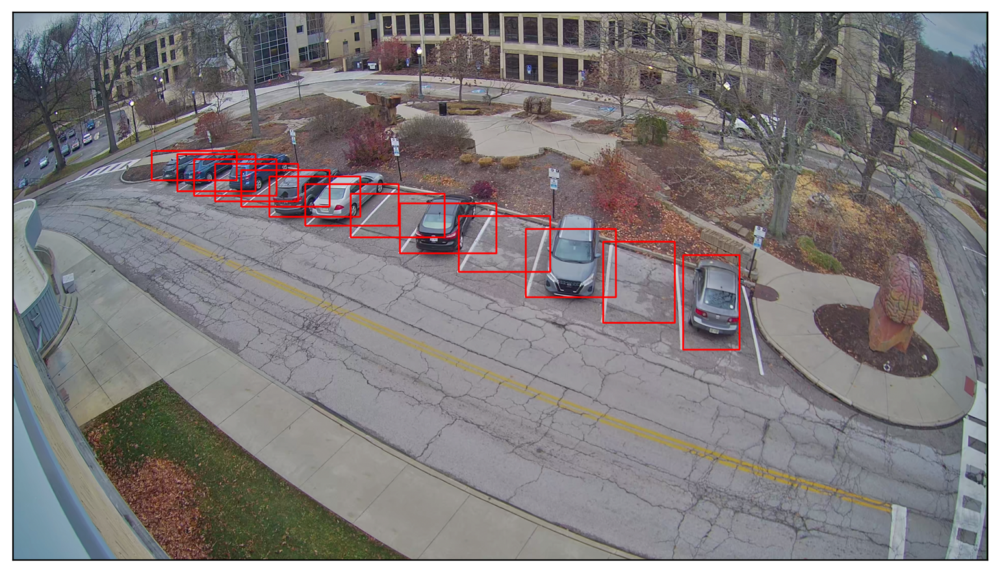

In [17]:
def assign_spots_map(image, spot_dict=final_spot_dict, make_copy = True, color=[255, 0, 0], thickness=5):
    if make_copy:
        new_image = np.copy(image)
    for spot in spot_dict.keys():
        (x1, y1, x2, y2) = spot
        cv2.rectangle(new_image, (int(x1),int(y1)), (int(x2),int(y2)), color, thickness)
    return new_image

marked_spot_images = list(map(assign_spots_map, images_test))
show_images(marked_spot_images)

In [18]:
import cv2
import os

image_path = '/content/drive/MyDrive/nisha/test_images/RGBparkinglot2.png'
image = cv2.imread(image_path)

def save_images_for_cnn(image, spot_dict=final_spot_dict, folder_name='/content/sample_data'):
    print(f"Image Shape: {image.shape}")

    for rect_coords, spot_id in spot_dict.items():
        x2, y2, x1, y1 = map(int, rect_coords)

        print(f"Processing spot {spot_id} with coordinates ({x1}, {y1}, {x2}, {y2})")

        # Check if the coordinates are within the image dimensions
        if 0 <= x1 < image.shape[1] and 0 <= y1 < image.shape[0] and x1 < x2 <= image.shape[1] and y1 < y2 <= image.shape[0]:
            # Crop this image
            spot_img = image[y1:y2, x1:x2]
            spot_img = cv2.resize(spot_img, (0, 0), fx=2.0, fy=2.0)

            filename = f'spot{spot_id}.png'
            print(f'Saving {filename} with shape {spot_img.shape}')

            cv2.imwrite(os.path.join(folder_name, filename), spot_img)
        else:
            print(f'Skipping spot {spot_id} due to invalid coordinates.')

# Call the function
save_images_for_cnn(image)


Image Shape: (2160, 3840, 3)
Processing spot 1 with coordinates (2640, 1330, 2862, 957)
Skipping spot 1 due to invalid coordinates.
Processing spot 2 with coordinates (2325, 1224, 2607, 904)
Skipping spot 2 due to invalid coordinates.
Processing spot 3 with coordinates (2020, 1123, 2375, 854)
Skipping spot 3 due to invalid coordinates.
Processing spot 4 with coordinates (1756, 1023, 2116, 803)
Skipping spot 4 due to invalid coordinates.
Processing spot 5 with coordinates (1524, 950, 1904, 753)
Skipping spot 5 due to invalid coordinates.
Processing spot 6 with coordinates (1330, 887, 1700, 715)
Skipping spot 6 due to invalid coordinates.
Processing spot 7 with coordinates (1151, 841, 1519, 677)
Skipping spot 7 due to invalid coordinates.
Processing spot 8 with coordinates (1010, 806, 1368, 647)
Skipping spot 8 due to invalid coordinates.
Processing spot 9 with coordinates (899, 766, 1247, 622)
Skipping spot 9 due to invalid coordinates.
Processing spot 10 with coordinates (796, 745, 112

In [ ]:
import cv2
import os

image_path = '/content/drive/MyDrive/nisha/test_images/RGBparkinglot2.png'
image = cv2.imread(image_path)

def save_images_for_cnn(image, spot_dict=final_spot_dict, folder_name='/content/sample_data'):
    print(f"Image Shape: {image.shape}")

    for rect_coords, spot_id in spot_dict.items():
        x2, y2, x1, y1 = map(int, rect_coords)

        print(f"Processing spot {spot_id} with coordinates ({x2}, {y2}, {x1}, {y1})")

        # Check if the coordinates are within the image dimensions
        if 0 <= x1 < image.shape[1] and 0 <= y1 < image.shape[0] and x1 < x2 <= image.shape[1] and y1 < y2 <= image.shape[0]:
            # Crop this image
            spot_img = image[y1:y2, x1:x2]
            spot_img = cv2.resize(spot_img, (0, 0), fx=2.0, fy=2.0)

            filename = f'spot{spot_id}.png'
            print(f'Saving {filename} with shape {spot_img.shape}')

            cv2.imwrite(os.path.join(folder_name, filename), spot_img)
        else:
            print(f'Skipping spot {spot_id} due to invalid coordinates.')

# Call the function
save_images_for_cnn(image)


Image Shape: (2160, 3840, 3)
Processing spot 1 with coordinates (2862, 957, 2640, 1330)
Skipping spot 1 due to invalid coordinates.
Processing spot 2 with coordinates (2607, 904, 2325, 1224)
Skipping spot 2 due to invalid coordinates.
Processing spot 3 with coordinates (2375, 854, 2020, 1123)
Skipping spot 3 due to invalid coordinates.
Processing spot 4 with coordinates (2116, 803, 1756, 1023)
Skipping spot 4 due to invalid coordinates.
Processing spot 5 with coordinates (1904, 753, 1524, 950)
Skipping spot 5 due to invalid coordinates.
Processing spot 6 with coordinates (1700, 715, 1330, 887)
Skipping spot 6 due to invalid coordinates.
Processing spot 7 with coordinates (1519, 677, 1151, 841)
Skipping spot 7 due to invalid coordinates.
Processing spot 8 with coordinates (1368, 647, 1010, 806)
Skipping spot 8 due to invalid coordinates.
Processing spot 9 with coordinates (1247, 622, 899, 766)
Skipping spot 9 due to invalid coordinates.
Processing spot 10 with coordinates (1123, 597, 79

In [ ]:
import cv2
import os

image_path = '/content/drive/MyDrive/nisha/test_images/RGBparkinglot2.png'
image = cv2.imread(image_path)

def save_images_for_cnn(image, spot_dict=final_spot_dict, folder_name='/content/sample_data'):
    print(f"Image Shape: {image.shape}")

    for rect_coords, spot_id in spot_dict.items():
        x1, y1, x2, y2 = map(int, rect_coords)

        print(f"Processing spot {spot_id} with coordinates ({x1}, {y1}, {x2}, {y2})")

        # Check if the coordinates are within the image dimensions
        if 0 <= x1 < image.shape[1] and 0 <= y1 < image.shape[0] and x1 < x2 <= image.shape[1] and y1 < y2 <= image.shape[0]:
            # Crop this image
            spot_img = image[y1:y2, x1:x2]
            spot_img = cv2.resize(spot_img, (0, 0), fx=2.0, fy=2.0)

            filename = f'spot{spot_id}.png'
            print(f'Saving {filename} with shape {spot_img.shape}')

            cv2.imwrite(os.path.join(folder_name, filename), spot_img)
        else:
            print(f'Skipping spot {spot_id} due to invalid coordinates.')

# Call the function
save_images_for_cnn(image)


Image Shape: (2160, 3840, 3)
Processing spot 1 with coordinates (2862, 957, 2640, 1330)
Skipping spot 1 due to invalid coordinates.
Processing spot 2 with coordinates (2607, 904, 2325, 1224)
Skipping spot 2 due to invalid coordinates.
Processing spot 3 with coordinates (2375, 854, 2020, 1123)
Skipping spot 3 due to invalid coordinates.
Processing spot 4 with coordinates (2116, 803, 1756, 1023)
Skipping spot 4 due to invalid coordinates.
Processing spot 5 with coordinates (1904, 753, 1524, 950)
Skipping spot 5 due to invalid coordinates.
Processing spot 6 with coordinates (1700, 715, 1330, 887)
Skipping spot 6 due to invalid coordinates.
Processing spot 7 with coordinates (1519, 677, 1151, 841)
Skipping spot 7 due to invalid coordinates.
Processing spot 8 with coordinates (1368, 647, 1010, 806)
Skipping spot 8 due to invalid coordinates.
Processing spot 9 with coordinates (1247, 622, 899, 766)
Skipping spot 9 due to invalid coordinates.
Processing spot 10 with coordinates (1123, 597, 79

In [ ]:
image_path = '/content/drive/MyDrive/nisha/test_images/RGBparkinglot2.png'
image = cv2.imread(image_path)

def save_images_for_cnn(image, spot_dict=final_spot_dict, folder_name='/content/sample_data'):
    for rect_coords, spot_id in spot_dict.items():
        x1, y1, x2, y2 = map(int, rect_coords)

        print(f"Processing spot {spot_id} with coordinates ({x1}, {y1}, {x2}, {y2})")

        # Check if the coordinates are within the image dimensions
        if 0 <= x1 < x2 <= image.shape[1] and 0 <= y1 < y2 <= image.shape[0]:
            # Crop this image
            spot_img = image[y1:y2, x1:x2]
            spot_img = cv2.resize(spot_img, (0, 0), fx=2.0, fy=2.0)

            filename = f'spot{spot_id}.png'
            print(f'Saving {filename} with shape {spot_img.shape}')

            cv2.imwrite(os.path.join(folder_name, filename), spot_img)
        else:
            print(f'Skipping spot {spot_id} due to invalid coordinates.')

In [ ]:
### Save spot dictionary as pickle file
import pickle

with open('spot_dict.pickle', 'wb') as handle:
    pickle.dump(final_spot_dict, handle, protocol=pickle.HIGHEST_PROTOCOL)

In [ ]:
## Imports for making predictions
import tensorflow
from PIL import Image
from keras.applications.imagenet_utils import preprocess_input
from keras.models import load_model
from keras.preprocessing import image

In [ ]:
cwd = os.getcwd()

class_dictionary = {}
class_dictionary[0] = 'empty'
class_dictionary[1] = 'occupied'

In [ ]:
from keras.models import load_model

# Replace 'your_model_path.keras' with the actual path to your model file
top_model_weights_path = '/content/drive/MyDrive/nisha/train_data/train/fine_tuning_vgg_model2.keras'
model = load_model(top_model_weights_path)
model.summary()

Model: "model_7"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_10 (InputLayer)       [(None, 224, 224, 3)]     0         
                                                                 
 sequential_2 (Sequential)   (None, 224, 224, 3)       0         
                                                                 
 tf.__operators__.getitem (  (None, 224, 224, 3)       0         
 SlicingOpLambda)                                                
                                                                 
 tf.nn.bias_add (TFOpLambda  (None, 224, 224, 3)       0         
 )                                                               
                                                                 
 vgg16 (Functional)          (None, 7, 7, 512)         14714688  
                                                                 
 flatten_7 (Flatten)         (None, 25088)             0   

In [ ]:
print(dir(model))
class_labels = model.__class__

# Print the class labels
print("Class Labels:", class_labels)

['_SCALAR_UPRANKING_ON', '_TF_MODULE_IGNORED_PROPERTIES', '__annotations__', '__call__', '__class__', '__copy__', '__deepcopy__', '__delattr__', '__dict__', '__dir__', '__doc__', '__eq__', '__format__', '__ge__', '__getattribute__', '__getstate__', '__gt__', '__hash__', '__init__', '__init_subclass__', '__le__', '__lt__', '__module__', '__ne__', '__new__', '__reduce__', '__reduce_ex__', '__repr__', '__setattr__', '__setstate__', '__sizeof__', '__str__', '__subclasshook__', '__weakref__', '_activity_regularizer', '_add_trackable', '_add_trackable_child', '_add_variable_with_custom_getter', '_aggregate_exact_metrics', '_assert_compile_was_called', '_assert_weights_created', '_auto_get_config', '_auto_track_sub_layers', '_autocast', '_autographed_call', '_base_model_initialized', '_build_input_shape', '_call_spec', '_callable_losses', '_captured_weight_regularizer', '_cast_single_input', '_check_call_args', '_check_sample_weight_warning', '_checkpoint', '_checkpoint_dependencies', '_clear

In [ ]:
def make_prediction(image):
    #Rescale image
    img = image/255.

    #Convert to a 4D tensor
    image = np.expand_dims(img, axis=0)

    # make predictions on the preloaded model
    class_predicted = model.predict(image)
    inID = np.argmax(class_predicted[0])
    label = class_dictionary[inID]
    return label

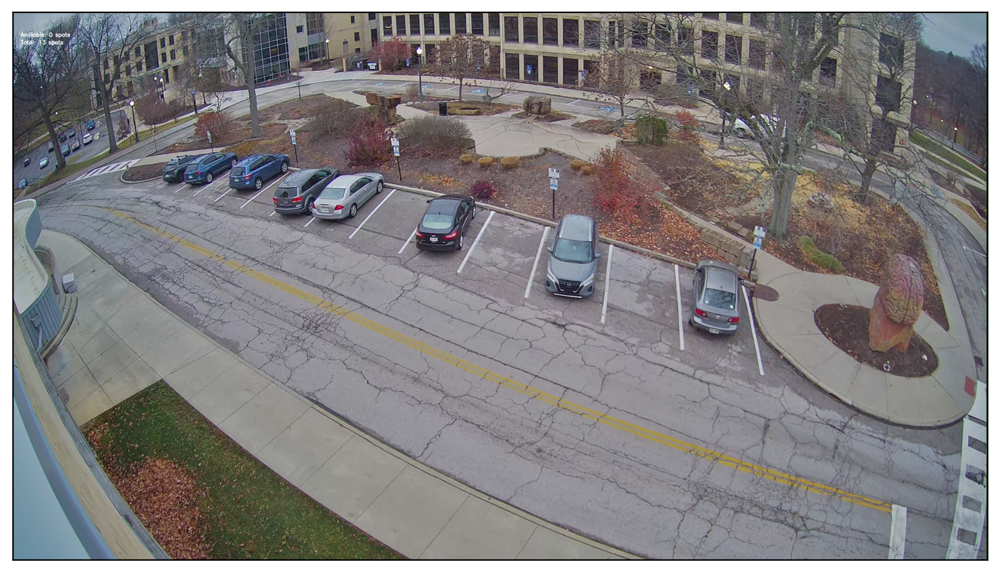

In [ ]:
def predict_and_mark_spots(image, spot_dict=final_spot_dict, make_copy=True, color=[255, 0, 0], thickness=5, alpha=0.5):
    if make_copy:
        new_image = np.copy(image)
    else:
        new_image = image.copy()

    cnt_empty = 0
    all_spots = len(spot_dict)

    for spot in spot_dict.keys():
        (x1, y1, x2, y2) = spot
        x1, y1, x2, y2 = int(x1), int(y1), int(x2), int(y2)

        # Check if the region has a valid width before making a prediction
        if x1 < x2:
            # Crop this image
            spot_img = image[y1:y2, x1:x2]  # Corrected the cropping indices
            spot_img = cv2.resize(spot_img, (48, 48))

            label = make_prediction(spot_img)
            # print(label)
            if label == 'empty':
                cv2.rectangle(new_image, (x1, y1), (x2, y2), color, thickness)
                cnt_empty += 1

    cv2.putText(new_image, "Available: %d spots" % cnt_empty, (30, 95),
                cv2.FONT_HERSHEY_SIMPLEX,
                0.7, (255, 255, 255), 2)

    cv2.putText(new_image, "Total: %d spots" % all_spots, (30, 125),
                cv2.FONT_HERSHEY_SIMPLEX,
                0.7, (255, 255, 255), 2)

    return new_image

predicted_marked_images = list(map(predict_and_mark_spots, images_test))
show_images(predicted_marked_images)
